In [1]:
#Cargar librerias
import tensorflow as tf
import numpy as np
import datetime

import tensorflow_hub as hub

print(tf.__version__)
import time

import PIL.Image as Image
import matplotlib.pylab as plt
import os
import shutil
import random

2.10.0


In [2]:
# Ruta de la carpeta principal original que contiene las subcarpetas de clases
folder_path = "../Data/PetroImages_Augmentedx3"

# Rutas para los subconjuntos de entrenamiento y validación
train_dir = "../Data/PetroImages_x3ST/train"
validation_dir = "../Data/PetroImages_x3ST/validation"

In [3]:
#Preparar dataset
# Proporción de datos para el conjunto de validación (porcentaje)
validation_split = 0.2
random.seed(123)

# Lista de las subcarpetas/clases
class_folders = os.listdir(folder_path)

# Itera a través de cada subcarpeta/clase
for class_folder in class_folders:
    class_path = os.path.join(folder_path, class_folder)
    if os.path.isdir(class_path):
        # Lista de archivos en la subcarpeta actual
        files = os.listdir(class_path)
        # Baraja (shuffle) los archivos de la clase para dividir aleatoriamente
        random.shuffle(files)
        # Calcula la cantidad de datos para el conjunto de validación
        num_validation = int(len(files) * validation_split)
        if num_validation == 0:
            num_validation = 1
        # Divide los archivos en los conjuntos de entrenamiento y validación
        train_files = files[num_validation:]
        validation_files = files[:num_validation]
        

        # Crea las rutas para las carpetas de entrenamiento y validación
        class_train_dir = os.path.join(train_dir, class_folder)
        class_validation_dir = os.path.join(validation_dir, class_folder)

        # Crea las carpetas de entrenamiento y validación si no existen
        os.makedirs(class_train_dir, exist_ok=True)
        os.makedirs(class_validation_dir, exist_ok=True)
        
        # Mueve los archivos a las carpetas correspondientes
        for file in train_files:
            src = os.path.join(class_path, file)
            dst = os.path.join(class_train_dir, file)
            shutil.copy(src, dst)

        for file in validation_files:
            src = os.path.join(class_path, file)
            dst = os.path.join(class_validation_dir, file)
            shutil.copy(src, dst)

In [4]:
#Cargar dataset
#Dividir dataset para entrenamiento y validación  
BATCH_SIZE = 64
IMG_SIZE = (224, 224)

# Crea el conjunto de datos de TensorFlow desde los directorios
train_ds = tf.keras.utils.image_dataset_from_directory(train_dir,
                                                            shuffle=True,
                                                            seed = 123,
                                                            batch_size=BATCH_SIZE,
                                                            image_size=IMG_SIZE)

val_ds = tf.keras.utils.image_dataset_from_directory(validation_dir,
                                                                 shuffle=True,
                                                                 seed = 123,
                                                                 batch_size=BATCH_SIZE,
                                                                 image_size=IMG_SIZE)

Found 19148 files belonging to 106 classes.
Found 4746 files belonging to 106 classes.


In [5]:

training_data = train_ds
validation_data = val_ds

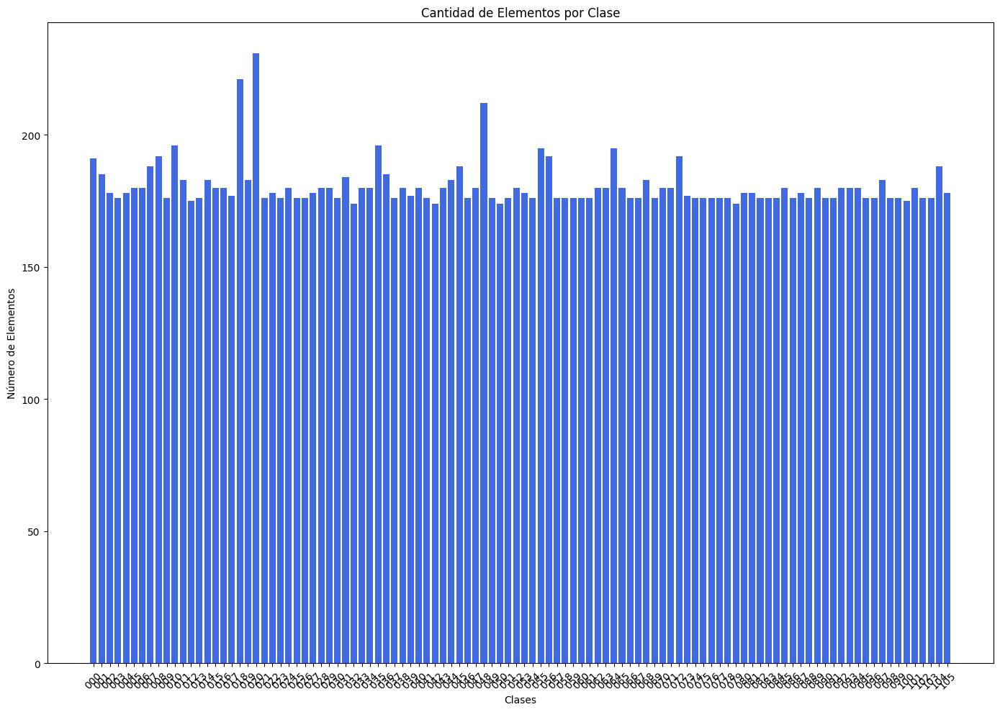

In [6]:
import matplotlib.pyplot as plt

# Lista de nombres de las clases
class_names = np.array(train_ds.class_names)

# Ruta de la carpeta principal
folder_path = train_dir 

# Listas para almacenar los nombres de las clases y la cantidad de elementos
class_names_list = []
element_count_list = []

# Itera a través de cada clase
for class_name in class_names:
    class_folder = os.path.join(folder_path, class_name)
    if os.path.exists(class_folder) and os.path.isdir(class_folder):
        # Obtiene la lista de elementos en la carpeta de la clase
        elements = os.listdir(class_folder)
        element_count = len(elements)
        class_names_list.append(class_name)
        element_count_list.append(element_count)

# Crea un gráfico de barras
plt.figure(figsize=(14, 10))
plt.bar(class_names_list, element_count_list, color='royalblue')
plt.xlabel('Clases')
plt.ylabel('Número de Elementos')
plt.title('Cantidad de Elementos por Clase')
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para mayor claridad

# Muestra el gráfico
plt.tight_layout()
plt.show()

In [7]:
std = np.std(element_count_list)
mean = np.mean(element_count_list)

print('Desviación estándar: ', std)
print('Media: ', mean)

cv = std/mean 
print('Coeficiente de variacion: ', cv)

Desviación estándar:  8.68004508209891
Media:  180.64150943396226
Coeficiente de variacion:  0.048051220947487185


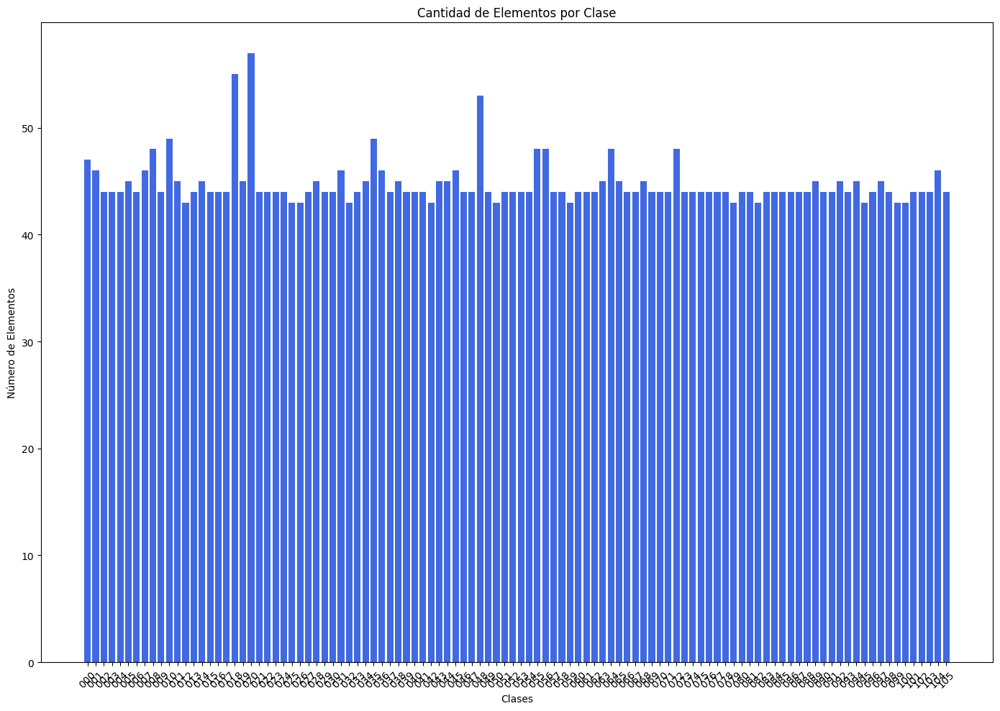

In [8]:
import matplotlib.pyplot as plt

# Lista de nombres de las clases
class_names = np.array(val_ds.class_names)

# Ruta de la carpeta principal
folder_path = validation_dir  # Reemplaza con tu ruta

# Listas para almacenar los nombres de las clases y la cantidad de elementos
class_names_list = []
element_count_list = []

# Itera a través de cada clase
for class_name in class_names:
    class_folder = os.path.join(folder_path, class_name)
    if os.path.exists(class_folder) and os.path.isdir(class_folder):
        # Obtiene la lista de elementos en la carpeta de la clase
        elements = os.listdir(class_folder)
        element_count = len(elements)
        class_names_list.append(class_name)
        element_count_list.append(element_count)

# Crea un gráfico de barras
plt.figure(figsize=(14, 10))
plt.bar(class_names_list, element_count_list, color='royalblue')
plt.xlabel('Clases')
plt.ylabel('Número de Elementos')
plt.title('Cantidad de Elementos por Clase')
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para mayor claridad

# Muestra el gráfico
plt.tight_layout()
plt.show()

In [9]:
std = np.std(element_count_list)
mean = np.mean(element_count_list)

print('Desviación estándar: ', std)
print('Media: ', mean)

cv = std/mean 
print('Coeficiente de variacion: ', cv)

Desviación estándar:  2.1687446106416624
Media:  44.77358490566038
Coeficiente de variacion:  0.04843803808007084


In [10]:
#Normalizar datasets
normalization_layer = tf.keras.layers.Rescaling(1./255)
train_ds = train_ds.map(lambda x, y: (normalization_layer(x), y)) # Where x—images, y—labels.
val_ds = val_ds.map(lambda x, y: (normalization_layer(x), y)) # Where x—images, y—labels.

In [11]:
#Mejorar rendimiento 
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().prefetch(buffer_size = AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size = AUTOTUNE)

In [12]:
#Imprimir las formas de los lotes de imágenes y etiquetas
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(64, 224, 224, 3)
(64,)


In [13]:
#Cargar modelo de extracción de características
mobilenet_v2 = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"
feature_extractor_model = mobilenet_v2

In [14]:
#Crear capa Keras a partir de un modelo de extracción de características
feature_extractor_layer = hub.KerasLayer(
    feature_extractor_model,
    input_shape=(224, 224, 3),
    trainable=False)

In [15]:
#Construir modelo 
num_classes = len(class_names)

model = tf.keras.Sequential([
  feature_extractor_layer,
  tf.keras.layers.Dense(num_classes)
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 106)               135786    
                                                                 
Total params: 2,393,770
Trainable params: 135,786
Non-trainable params: 2,257,984
_________________________________________________________________


In [16]:
#Compilar modelo
model.compile(
  optimizer = tf.keras.optimizers.Adam(),
  loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits = True),
  metrics = ['acc'])

log_dir = "Logs/MN_x3/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(
    log_dir=log_dir,
    histogram_freq=1) # Habilitar el cálculo del histograma para cada época.

In [17]:
#Definir epocas
num_epochs = 50

In [18]:
#Entrenar el modelo utilizando los conjuntos de datos de entrenamiento y validación.
#Registro de TensorBoard para el seguimiento del progreso del entrenamiento.
history = model.fit(train_ds,
                    validation_data = val_ds,
                    epochs = num_epochs,
                    callbacks = tensorboard_callback)

Epoch 1/50
300/300 [==============================] - 116s 366ms/step - loss: 2.2709 - acc: 0.4699 - val_loss: 1.4341 - val_acc: 0.6416
Epoch 2/50
300/300 [==============================] - 96s 320ms/step - loss: 1.0901 - acc: 0.7446 - val_loss: 0.9975 - val_acc: 0.7545
Epoch 3/50
300/300 [==============================] - 97s 323ms/step - loss: 0.7492 - acc: 0.8331 - val_loss: 0.7876 - val_acc: 0.8062
Epoch 4/50
300/300 [==============================] - 98s 329ms/step - loss: 0.5637 - acc: 0.8812 - val_loss: 0.6630 - val_acc: 0.8361
Epoch 5/50
300/300 [==============================] - 97s 323ms/step - loss: 0.4451 - acc: 0.9131 - val_loss: 0.5805 - val_acc: 0.8580
Epoch 6/50
300/300 [==============================] - 97s 324ms/step - loss: 0.3620 - acc: 0.9333 - val_loss: 0.5217 - val_acc: 0.8708
Epoch 7/50
300/300 [==============================] - 97s 325ms/step - loss: 0.3003 - acc: 0.9492 - val_loss: 0.4778 - val_acc: 0.8786
Epoch 8/50
300/300 [==============================] - 

In [19]:
#Cargar biblioteca de graficos
import matplotlib.pyplot as plt

In [1]:
#Cargar y recargar la extensión de TensorBoard
%load_ext tensorboard
%reload_ext tensorboard

In [2]:
#iniciar TensorBoard y especificar la ubicación de los registros de entrenamiento y puerto.
%tensorboard --logdir Logs/MN_x3/fit --port=6007 #--host localhost
#%tensorboard --logdir {logs_base_dir}  --host localhost

In [22]:
#Realizar predicciones en el conjunto de datos de validación utilizando el modelo entrenado previamente.
predicted_val = model.predict(validation_data)
predicted_id = tf.math.argmax(predicted_val, axis=-1)
predicted_label = class_names[predicted_id]
print(len(predicted_label))
print(predicted_label)

75/75 [==============================] - 21s 250ms/step
4746
['005' '051' '042' ... '042' '064' '058']


In [23]:
predicted_val = model.predict(val_ds)
predicted_id = tf.math.argmax(predicted_val, axis =- 1)
predicted_label = class_names[predicted_id]
print(len(predicted_label))
print(predicted_label)

75/75 [==============================] - 18s 234ms/step
4746
['098' '068' '104' ... '050' '095' '033']


In [24]:
# Inicializa una variable para contar las imágenes
num_images = 0

# Itera a través del conjunto de datos y cuenta las imágenes
for batch in val_ds:
    num_images += batch[0].shape[0]

print("Número de imágenes en el conjunto de datos:", num_images)

Número de imágenes en el conjunto de datos: 4746


In [25]:
#Visualizar imágenes del conjunto de datos de validación junto con sus etiquetas reales y las etiquetas predichas por el modelo.
plt.figure(figsize=(50, 400))
plt.subplots_adjust(hspace = 1.5)
plt.subplots_adjust(wspace = 0.9)
batch_number = 0
real_labels = np.empty(shape = num_images, dtype = np.int8)
for image_batch, labels_batch in val_ds:
    for i in range(labels_batch.shape[0]):
        ax = plt.subplot(163, 30, i + 1 + batch_number)
        plt.imshow(image_batch[i])
        plt.title("pred: " + str(int(predicted_label[i])) + " | real: " + str(labels_batch[i].numpy()))
        real_labels[batch_number + i] = int(labels_batch[i].numpy())
        plt.axis("off")
    batch_number = batch_number + 64

In [26]:
#Almacenar las etiquetas predichas por el modelo como enteros.
predicted_label_cm = np.empty(shape = num_images, dtype = np.int8)
for i in range(len(predicted_label_cm)):
    predicted_label_cm[i] = int(predicted_label[i])
print(predicted_label_cm)

[ 98  68 104 ...  50  95  33]


In [27]:
#Matriz de confusión utilizando las etiquetas reales y las etiquetas predichas por tu modelo.
cm = tf.math.confusion_matrix(
    real_labels,
    predicted_label_cm
)

print(cm.numpy())

[[47  0  0 ...  0  0  0]
 [ 0 35  3 ...  1  0  0]
 [ 0  0 44 ...  0  0  0]
 ...
 [ 0  0  0 ... 41  0  0]
 [ 0  0  0 ...  0 39  0]
 [ 0  0  0 ...  0  0 44]]


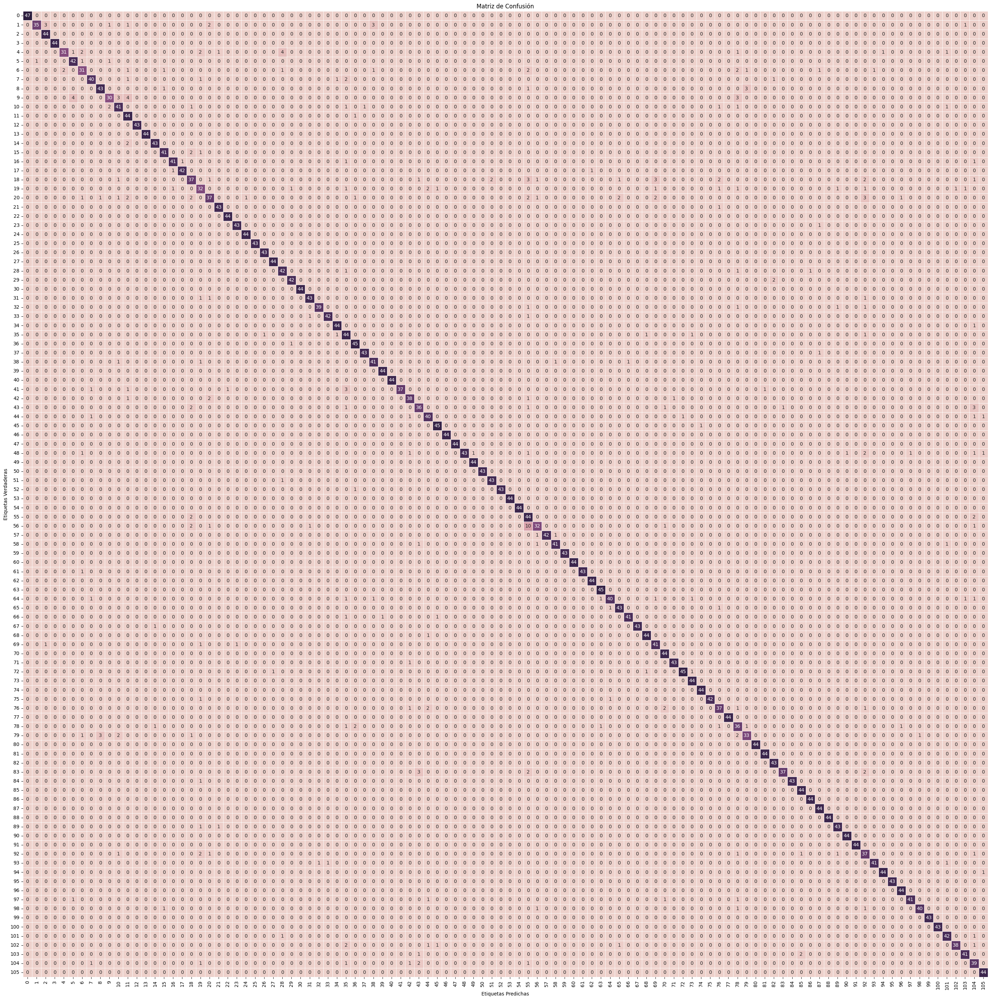

In [28]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# las etiquetas verdaderas y predichas
# test_true_labels y test_predicted_labels

C = confusion_matrix(real_labels, predicted_label_cm)

# Ajusta el tamaño de la figura
plt.figure(figsize = (36, 36))

# Utiliza un mapa de colores personalizado
cmap = sns.cubehelix_palette(as_cmap = True)

# Dibuja la matriz de confusión con anotaciones y un borde
sns.heatmap(cm.numpy(), cmap = cmap, square = True, annot = True, fmt = 'd', linewidths = .5, cbar = False)

# Añade etiquetas de los ejes
plt.xlabel('Etiquetas Predichas')
plt.ylabel('Etiquetas Verdaderas')

# Añade un título
plt.title('Matriz de Confusión')

# Muestra el gráfico
plt.show()

In [29]:
#Metricas
from sklearn.metrics import accuracy_score, matthews_corrcoef, balanced_accuracy_score

In [30]:
#Real_labels son las etiquetas reales y predicted_label son las etiquetas predichas por el modelo
accuracy = accuracy_score(real_labels, predicted_label_cm)
print(f'Accuracy: {accuracy}')

Accuracy: 0.9315212810788032


In [31]:
#Real_labels son las etiquetas reales y predicted_label son las etiquetas predichas por el modelo
mcc = matthews_corrcoef(real_labels, predicted_label_cm)
print(f'Matthews Correlation Coefficient: {mcc}')

Matthews Correlation Coefficient: 0.9309120478458064


In [32]:
#Real_labels son las etiquetas reales y predicted_label son las etiquetas predichas por el modelo
bal_acc=balanced_accuracy_score(real_labels, predicted_label_cm)
print(f'balanced_accuracy_score: {bal_acc}')

balanced_accuracy_score: 0.93381564484129


In [33]:
#Guardar el modelo entrenado.
t = time.time()

export_path = "../Models/ModelMN_x3/{}".format(int(t))
model.save(export_path)


export_path

INFO:tensorflow:Assets written to: Models/ModelMN_x3/1699833235\assets


INFO:tensorflow:Assets written to: Models/ModelMN_x3/1699833235\assets


'Models/ModelMN_x3/1699833235'

In [34]:
#Cargar un modelo previamente guardado
reloaded = tf.keras.models.load_model(export_path)

In [35]:
result_batch = model.predict(image_batch)
reloaded_result_batch = reloaded.predict(image_batch)

1/1 [==============================] - 0s 396ms/step


In [36]:
abs(reloaded_result_batch - result_batch).max()

0.0

In [37]:
reloaded_predicted_id = tf.math.argmax(reloaded_result_batch, axis=-1)
reloaded_predicted_label_batch = class_names[reloaded_predicted_id]
print(reloaded_predicted_label_batch)

['089' '051' '048' '069' '065' '068' '010' '050' '095' '033']


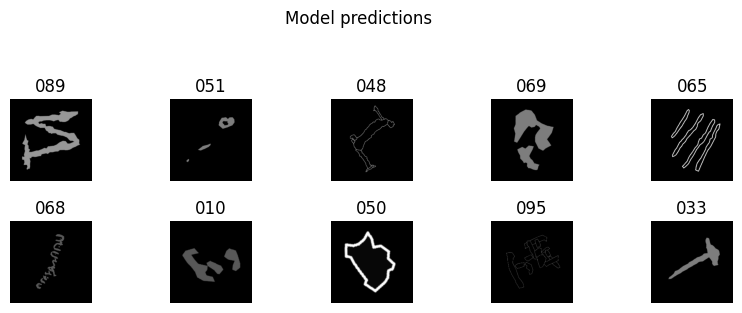

In [39]:
plt.figure(figsize=(10,9))
plt.subplots_adjust(hspace=0.5)
for n in range(10):
  plt.subplot(6,5,n+1)
  plt.imshow(image_batch[n])
  plt.title(reloaded_predicted_label_batch[n].title())
  plt.axis('off')
_ = plt.suptitle("Model predictions")